# Shift-VAE: Application to 1D spectra with arbitrary offset in peak position

Prepared by Maxim Ziatdinov


---

This notebook denonstrates how to use shift-VAE to disentangle the representations of a 1D spectral data set, ignoring relative positions of the peaks.

---



E-mail: ziatdinovmax@gmail.com

Install pyroVED package:

In [ ]:
# Install the latest version from source
# (or you may instal a stable version from PyPi instead with !pip install pyroved)
!pip install -q git+https://github.com/ziatdinovmax/pyroved.git

  Preparing metadata (setup.py) ... done


In [ ]:
import os
import math
import numpy as np
import seaborn as sns
import pandas as pd
import time
import random

import torch

from torch.nn import Conv1d, ConvTranspose1d
from torch.nn import Linear as Lin, ReLU, Sigmoid, ConstantPad1d
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import StratifiedKFold

from matplotlib import pyplot as plt
from tqdm import tqdm

In [ ]:
import pyroved as pv
import torch
import matplotlib.pyplot as plt

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:

X_train = np.load("/content/drive/MyDrive/Aerosols_Proj/Lab_X_train.npy")
Y_train = np.load("/content/drive/MyDrive/Aerosols_Proj/Lab_Y_train.npy")

X_val = np.load("/content/drive/MyDrive/Aerosols_Proj/Lab_X_val.npy")
Y_val = np.load("/content/drive/MyDrive/Aerosols_Proj/Lab_Y_val.npy")

X_test = np.load("/content/drive/MyDrive/Aerosols_Proj/Lab_X_test.npy")
Y_test = np.load("/content/drive/MyDrive/Aerosols_Proj/Lab_Y_test.npy")

In [ ]:
X_train.shape

(140082, 400, 4)

In [ ]:
Y_train.shape

(140082,)

[ 0.30851921  0.02647253 -0.02564527  0.24578686]
[ 0.08980793  0.25976175  0.50876903 -0.05247831]
[ 0.27648699  0.0272998  -0.03143614 -0.75954151]
[ 0.32416357  0.01571807 -0.00413633  0.21248451]
[ 0.3017658  -0.02647253 -0.0521178  -0.52992565]


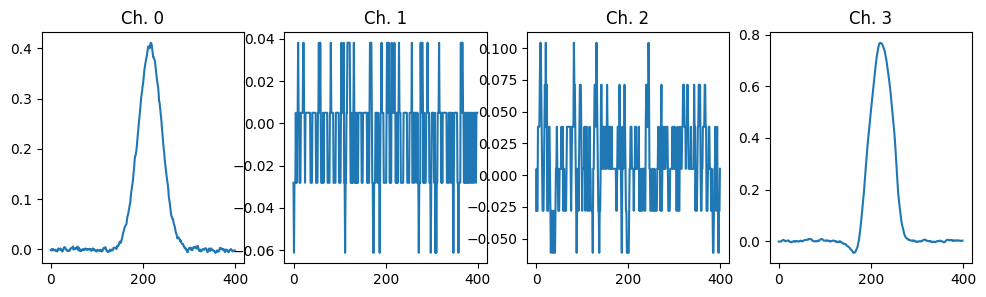

In [ ]:
n = random.randint(1, 140081)
fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(12,3))
axes[0].plot(X_train[n,:,0])
axes[0].set_title("Ch. 0")
axes[1].plot(X_train[n,:,1])
axes[1].set_title("Ch. 1")
axes[2].plot(X_train[n,:,2])
axes[2].set_title("Ch. 2")
axes[3].plot(X_train[n,:,3])
axes[3].set_title("Ch. 3")

random_indices = [random.randint(0, 140081) for _ in range(5)]

for idx in random_indices:
    print(X_train[idx, 199, :])

#print out the channel 0, 1, 2, 3, 4 for one random aerosol sample in X_train.
#this will be acorss a 400 point time series


In [ ]:
original_max_X_train = np.zeros((140082, 4))
for p_idx in range(140082):
  for c_idx in range(4):
    original_max_X_train[p_idx][c_idx] = np.max(X_train[p_idx, :, c_idx])


In [ ]:
X_train.shape

(140082, 400, 4)

In [ ]:
peak_height = np.max(X_train[:, :, 1])
print(peak_height)

132.61664460622106


In [ ]:
#SATURATION NUMERIC

eps = 0.001

max_signal_channel_0 = np.max(X_train[:, :, 0], axis=1)

count_max_signal_channel_0 = np.sum((X_train[:, :, 0] >= (max_signal_channel_0[:, np.newaxis] - eps)) &
                                    (X_train[:, :, 0] <= (max_signal_channel_0[:, np.newaxis] + eps)), axis=1)

print(count_max_signal_channel_0/400*100)
count_max_signal_channel_0.shape





[ 0.25  0.5   0.25 ... 14.25  8.75 28.75]


(140082,)

In [ ]:
max1 = np.max(X_train[:, :, 1], axis=1)
max2 = np.max(X_train[:, :, 2], axis=1)

# Calculate the color channel ratio for all 400 points
color_channel_ratio = max2 / max1

color_channel_ratio

array([1.11002002, 1.08262394, 1.21032505, ..., 1.52508171, 1.49707908,
       1.61149563])

In [ ]:
channel_min_X_train = np.zeros((140082, 4))
channel_max_X_train = np.zeros((140082, 4))

# WOULD APPLY SAME LOGIC TO VALIDATION AND TEST DATASETS

for p_idx in range(140082):
  for c_idx in range(4):
    channel_min_X_train[p_idx][c_idx] = np.min(X_train[p_idx, :, c_idx])

  for c_idx in range(4):
    channel_max_X_train[p_idx][c_idx] = np.max(X_train[p_idx, :, c_idx])


for p_idx in range (0,140082):
  for c_idx in range(0, 4):
    s0 = (X_train[p_idx,:,c_idx] - channel_min_X_train[p_idx][c_idx])/(channel_max_X_train[p_idx][c_idx]- channel_min_X_train[p_idx][c_idx])
    X_train[p_idx,:,c_idx] = s0

X_train

array([[[4.01606426e-03, 2.49376559e-03, 6.71140940e-03, 2.07009858e-01],
        [4.01606426e-03, 0.00000000e+00, 4.47427293e-03, 2.07009858e-01],
        [2.67737617e-03, 0.00000000e+00, 4.47427293e-03, 2.07009858e-01],
        ...,
        [5.35475234e-03, 2.49376559e-03, 6.71140940e-03, 2.07009858e-01],
        [1.07095047e-02, 2.49376559e-03, 1.11856823e-02, 2.07009858e-01],
        [8.03212851e-03, 2.49376559e-03, 8.94854586e-03, 2.07009858e-01]],

       [[1.90476190e-01, 5.76923077e-02, 7.01754386e-02, 3.93442623e-01],
        [1.90476190e-01, 5.76923077e-02, 7.01754386e-02, 3.77049180e-01],
        [2.38095238e-01, 3.84615385e-02, 5.26315789e-02, 3.93442623e-01],
        ...,
        [1.42857143e-01, 3.84615385e-02, 5.26315789e-02, 2.95081967e-01],
        [9.52380952e-02, 3.84615385e-02, 3.50877193e-02, 2.62295082e-01],
        [7.14285714e-02, 3.84615385e-02, 3.50877193e-02, 2.62295082e-01]],

       [[4.16666667e-01, 1.33333333e-01, 1.05263158e-01, 5.55555556e-01],
        

In [ ]:
print(type(X_train))

<class 'numpy.ndarray'>


In [ ]:
X_train_C0 = torch.from_numpy(X_train[:,:, 0]).float()

train_loader_0 = pv.utils.init_dataloader(X_train_C0.unsqueeze(1), batch_size=64)

fig, axes = plt.subplots(8, 8, figsize=(8, 8), dpi=300,  # Increased dpi here for higher resolution
                         subplot_kw={'xticks':[], 'yticks':[]},
                         gridspec_kw=dict(hspace=0.1, wspace=0.1))

for ax, (y,) in zip(axes.flat, train_loader_0):
    y_use = y.numpy()
    ax.plot(y_use[0, 0])

plt.savefig('high_res_figure.png', dpi=300)
plt.close(fig)

from google.colab import files
files.download('high_res_figure.png')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
X_train_C1 = torch.from_numpy(X_train[:,:, 1]).float()

train_loader_1 = pv.utils.init_dataloader(X_train_C1.unsqueeze(1), batch_size=64)

fig, axes = plt.subplots(8, 8, figsize=(8, 8), dpi=300,
                         subplot_kw={'xticks':[], 'yticks':[]},
                         gridspec_kw=dict(hspace=0.1, wspace=0.1))

for ax, (y,) in zip(axes.flat, train_loader_1):
    y_use = y.numpy()
    ax.plot(y_use[0, 0])

plt.savefig('high_res_figure_channel_1.png', dpi=300)
plt.close(fig)

from google.colab import files
files.download('high_res_figure_channel_1.png')



<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
channel_0 = (140081, )

# Initialize vanilla VAE
# Insert the color channel ratio here?

vae = pv.models.iVAE(data_dim = (400,), latent_dim = 2, invariances=None, seed=0)

# Initialize SVI trainer
trainer = pv.trainers.SVItrainer(vae)

# Train for n epochs:
for e in range(55):
    trainer.step(train_loader_0)
    trainer.print_statistics()

Epoch: 1 Training loss: 84.7460
Epoch: 2 Training loss: 79.6206
Epoch: 3 Training loss: 78.9886
Epoch: 4 Training loss: 78.6018
Epoch: 5 Training loss: 78.3127
Epoch: 6 Training loss: 78.1704
Epoch: 7 Training loss: 78.0525
Epoch: 8 Training loss: 77.9271
Epoch: 9 Training loss: 77.8932
Epoch: 10 Training loss: 77.7721
Epoch: 11 Training loss: 77.7879
Epoch: 12 Training loss: 77.6806
Epoch: 13 Training loss: 77.6442
Epoch: 14 Training loss: 77.6252
Epoch: 15 Training loss: 77.5802
Epoch: 16 Training loss: 77.5655
Epoch: 17 Training loss: 77.5099
Epoch: 18 Training loss: 77.4890
Epoch: 19 Training loss: 77.4737
Epoch: 20 Training loss: 77.4233
Epoch: 21 Training loss: 77.4357
Epoch: 22 Training loss: 77.3958
Epoch: 23 Training loss: 77.4277
Epoch: 24 Training loss: 77.4968
Epoch: 25 Training loss: 77.3999
Epoch: 26 Training loss: 77.3724
Epoch: 27 Training loss: 77.3477
Epoch: 28 Training loss: 77.3313
Epoch: 29 Training loss: 77.3307
Epoch: 30 Training loss: 77.3898
Epoch: 31 Training 

In [ ]:
channel_1 = (140081, )

# Initialize vanilla VAE
# Insert the color channel ratio here?

vae = pv.models.iVAE(data_dim = (400,), latent_dim = 2, invariances=None, seed=0)

# Initialize SVI trainer
trainer = pv.trainers.SVItrainer(vae)

# Train for n epochs:
for e in range(55):
    trainer.step(train_loader_1)
    trainer.print_statistics()

Epoch: 1 Training loss: 148.4755
Epoch: 2 Training loss: 140.6733
Epoch: 3 Training loss: 139.3718
Epoch: 4 Training loss: 138.8700
Epoch: 5 Training loss: 138.6209
Epoch: 6 Training loss: 138.4121
Epoch: 7 Training loss: 138.4331
Epoch: 8 Training loss: 138.2402
Epoch: 9 Training loss: 138.1931
Epoch: 10 Training loss: 138.1246
Epoch: 11 Training loss: 138.1039
Epoch: 12 Training loss: 137.9759
Epoch: 13 Training loss: 137.9008
Epoch: 14 Training loss: 137.8970
Epoch: 15 Training loss: 137.8428
Epoch: 16 Training loss: 137.8185
Epoch: 17 Training loss: 137.8038
Epoch: 18 Training loss: 137.7606
Epoch: 19 Training loss: 137.8834
Epoch: 20 Training loss: 137.8990
Epoch: 21 Training loss: 137.7685
Epoch: 22 Training loss: 137.7030
Epoch: 23 Training loss: 137.7055
Epoch: 24 Training loss: 137.6685
Epoch: 25 Training loss: 137.7240
Epoch: 26 Training loss: 137.5960
Epoch: 27 Training loss: 137.5881
Epoch: 28 Training loss: 137.6359
Epoch: 29 Training loss: 137.8413
Epoch: 30 Training loss

**ANALYZING OUTLIERS + Encode the training data into the latent space:**

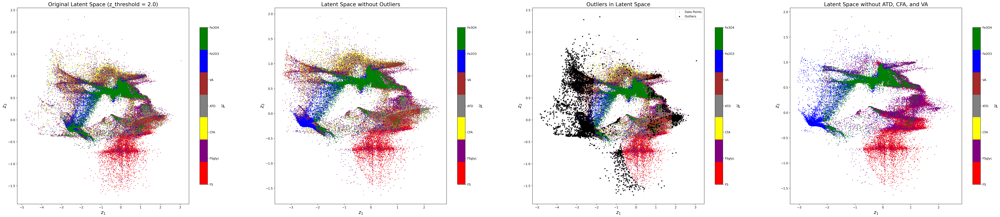

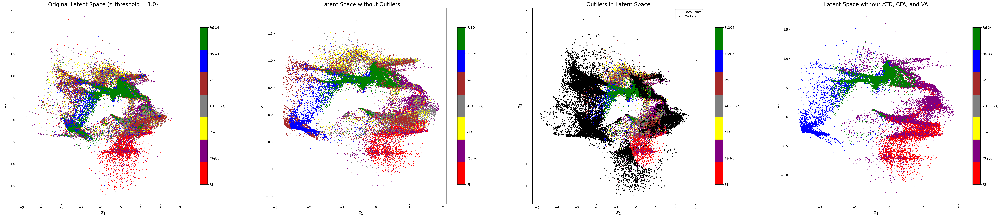

In [ ]:
#ANALYZING OUTLIERS

from scipy.spatial.distance import cdist

def identify_outliers(latent_space, labels, z_threshold=3.0):
    unique_labels = np.unique(labels)
    outliers = []
    all_distances = []
    outlier_indices = []

    for label in unique_labels:
        cluster_points = latent_space[labels == label]
        centroid = cluster_points.mean(axis=0)
        distances = cdist(cluster_points, [centroid], metric='euclidean').flatten()
        all_distances.extend(distances)
        mean_distance = distances.mean()
        std_distance = distances.std()
        threshold = mean_distance + z_threshold * std_distance
        cluster_outliers = cluster_points[distances > threshold]
        outliers.append(cluster_outliers)
        outlier_indices.extend(np.where(labels == label)[0][distances > threshold])

    if outliers:
        all_outliers = np.vstack(outliers)
    else:
        all_outliers = np.array([]).reshape(0, latent_space.shape[1])

    return all_outliers, all_distances, outlier_indices

def plot_latent_space_with_threshold(z_threshold):
    outliers, all_distances, outlier_indices = identify_outliers(z_mean, Y_train, z_threshold)

    non_outlier_mask = np.ones(len(z_mean), dtype=bool)
    non_outlier_mask[outlier_indices] = False

    z_mean_filtered = z_mean[non_outlier_mask]
    Y_train_filtered = Y_train[non_outlier_mask]

    # removing "ATD", "CFA", and "VA"
    classes_to_remove = [3, 2, 4]
    class_mask = ~np.isin(Y_train_filtered, classes_to_remove)

    z_mean_class_filtered = z_mean_filtered[class_mask]
    Y_train_class_filtered = Y_train_filtered[class_mask]

    fig, axes = plt.subplots(1, 4, figsize=(60, 12), dpi=300)

    target_names = ["FS", "FSglyc", "CFA", "ATD", "VA", "Fe2O3", "Fe3O4"]
    cmap1 = ListedColormap(['red', 'purple', 'yellow', 'gray', 'brown', 'blue', 'green'])

    # Plot the original latent space
    im1 = axes[0].scatter(z_mean[:, -1], z_mean[:, -2], s=1, c=Y_train, cmap=cmap1, label='Data Points')
    axes[0].set_title(f"Original Latent Space (z_threshold = {z_threshold})", fontsize=18)
    axes[0].set_xlabel("$z_1$", fontsize=16)
    axes[0].set_ylabel("$z_2$", fontsize=16)
    cbar1 = fig.colorbar(im1, ax=axes[0], ticks=range(len(cmap1.colors)), shrink=.8)
    cbar1.set_ticklabels(target_names)
    cbar1.set_label("$\mu$", fontsize=16)

    # Plot the latent space without outliers
    im2 = axes[1].scatter(z_mean_filtered[:, -1], z_mean_filtered[:, -2], s=1, c=Y_train_filtered, cmap=cmap1, label='Data Points')
    axes[1].set_title("Latent Space without Outliers", fontsize=18)
    axes[1].set_xlabel("$z_1$", fontsize=16)
    axes[1].set_ylabel("$z_2$", fontsize=16)
    cbar2 = fig.colorbar(im2, ax=axes[1], ticks=range(len(cmap1.colors)), shrink=.8)
    cbar2.set_ticklabels(target_names)
    cbar2.set_label("$\mu$", fontsize=16)

    # Plot the outliers
    im3 = axes[2].scatter(z_mean[:, -1], z_mean[:, -2], s=1, c=Y_train, cmap=cmap1, label='Data Points')
    axes[2].scatter(outliers[:, -1], outliers[:, -2], s=10, c='black', marker='x', label='Outliers')
    axes[2].set_title("Outliers in Latent Space", fontsize=18)
    axes[2].set_xlabel("$z_1$", fontsize=16)
    axes[2].set_ylabel("$z_2$", fontsize=16)
    cbar3 = fig.colorbar(im3, ax=axes[2], ticks=range(len(cmap1.colors)), shrink=.8)
    cbar3.set_ticklabels(target_names)
    cbar3.set_label("$\mu$", fontsize=16)
    axes[2].legend()

    # Plot the latent space without  specific classes
    im4 = axes[3].scatter(z_mean_class_filtered[:, -1], z_mean_class_filtered[:, -2], s=1, c=Y_train_class_filtered, cmap=cmap1, label='Data Points')
    axes[3].set_title("Latent Space without ATD, CFA, and VA", fontsize=18)
    axes[3].set_xlabel("$z_1$", fontsize=16)
    axes[3].set_ylabel("$z_2$", fontsize=16)
    cbar4 = fig.colorbar(im4, ax=axes[3], ticks=range(len(cmap1.colors)), shrink=.8)
    cbar4.set_ticklabels(target_names)
    cbar4.set_label("$\mu$", fontsize=16)


z_mean, z_sd = vae.encode(X_train_C0)

plot_latent_space_with_threshold(3.0)
plot_latent_space_with_threshold(2.0)

plt.show()


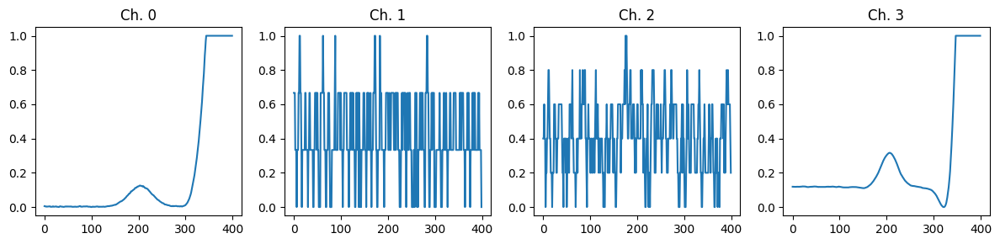

Channel values for the selected outlier at index 53361
Channel 0 at time point 199: 0.11994288434079012
Channel 1 at time point 199: 0.6666666666666666
Channel 2 at time point 199: 0.4000000000000001
Channel 3 at time point 199: 0.2994562944374739


In [ ]:
random_outlier_index = random.choice(outlier_indices)

fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(12, 3))
axes[0].plot(X_train[random_outlier_index, :, 0])
axes[0].set_title("Ch. 0")
axes[1].plot(X_train[random_outlier_index, :, 1])
axes[1].set_title("Ch. 1")
axes[2].plot(X_train[random_outlier_index, :, 2])
axes[2].set_title("Ch. 2")
axes[3].plot(X_train[random_outlier_index, :, 3])
axes[3].set_title("Ch. 3")

plt.tight_layout()
plt.show()

print("Channel values for the selected outlier at index", random_outlier_index)
for ch in range(4):
    print(f"Channel {ch} at time point 199:", X_train[random_outlier_index, 199, ch])

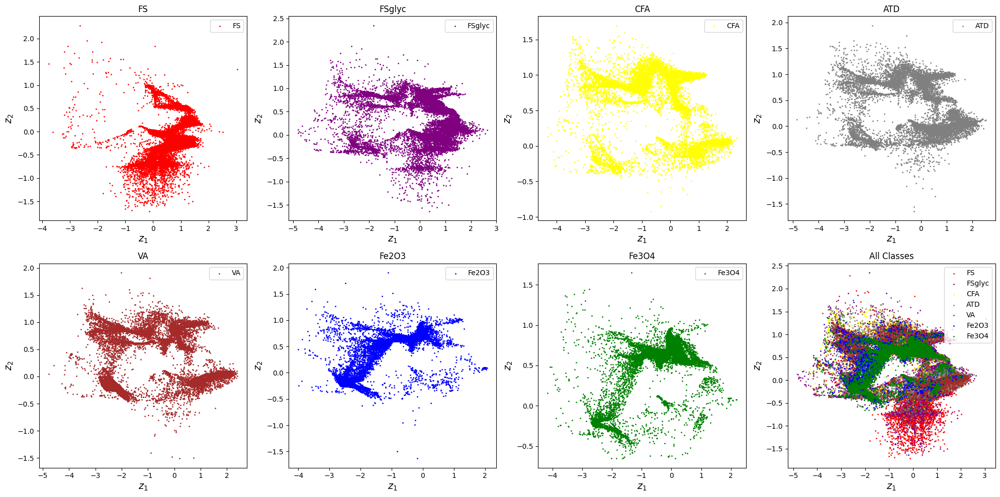

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
#Channel 0, 2D
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import numpy as np
from google.colab import files

z_mean, z_sd = vae.encode(X_train_C0)

target_names = ["FS", "FSglyc", "CFA", "ATD", "VA", "Fe2O3", "Fe3O4"]
cmap1 = ListedColormap(['red', 'purple', 'yellow', 'gray', 'brown', 'blue', 'green'])


fig, axs = plt.subplots(2, 4, figsize=(20, 10))

for idx_0 in range(7):
    class_indices = np.where(Y_train == idx_0)
    z_mean_class = z_mean[class_indices]


    ax = axs[idx_0 // 4, idx_0 % 4]
    ax.scatter(z_mean_class[:, -1], z_mean_class[:, -2], s=1, color=cmap1(idx_0), label=target_names[idx_0])
    ax.set_xlabel("$z_1$", fontsize=14)
    ax.set_ylabel("$z_2$", fontsize=14)
    ax.legend()
    ax.set_title(target_names[idx_0])


ax_all = axs[1, 3]
for idx_0 in range(7):
    class_indices = np.where(Y_train == idx_0)
    z_mean_class = z_mean[class_indices]
    ax_all.scatter(z_mean_class[:, -1], z_mean_class[:, -2], s=1, color=cmap1(idx_0), label=target_names[idx_0])

ax_all.set_xlabel("$z_1$", fontsize=14)
ax_all.set_ylabel("$z_2$", fontsize=14)
ax_all.legend()
ax_all.set_title("All Classes")

plt.tight_layout()
filename = 'individualAerosolClass.png'
plt.savefig(filename, dpi=300)
plt.show()

files.download(filename)


In [ ]:
#Channel 1, 2D
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import numpy as np
from google.colab import files

z_mean_1, z_sd_1 = vae.encode(X_train_C1)

target_names = ["FS", "FSglyc", "CFA", "ATD", "VA", "Fe2O3", "Fe3O4"]
cmap1 = ListedColormap(['red', 'purple', 'yellow', 'gray', 'brown', 'blue', 'green'])

fig, axs = plt.subplots(2, 4, figsize=(20, 10))

for idx_1 in range(7):
    class_indices = np.where(Y_train == idx_1)
    z_mean_class = z_mean_1[class_indices]

    ax = axs[idx_1 // 4, idx_1 % 4]
    ax.scatter(z_mean_class[:, -1], z_mean_class[:, -2], s=1, color=cmap1(idx_1), label=target_names[idx_1])
    ax.set_xlabel("$z_1$", fontsize=14)
    ax.set_ylabel("$z_2$", fontsize=14)
    ax.legend()
    ax.set_title(target_names[idx_1])

ax_all = axs[1, 3]
for idx_1 in range(7):
    class_indices = np.where(Y_train == idx_1)
    z_mean_class = z_mean_1[class_indices]
    ax_all.scatter(z_mean_class[:, -1], z_mean_class[:, -2], s=1, color=cmap1(idx_1), label=target_names[idx_1])

ax_all.set_xlabel("$z_1$", fontsize=14)
ax_all.set_ylabel("$z_2$", fontsize=14)
ax_all.legend()
ax_all.set_title("All Classes")

plt.tight_layout()
filename = 'individualAerosolClass_1.png'
plt.savefig(filename, dpi=300)
plt.show()

files.download(filename)

In [ ]:
X_train_C0.shape

torch.Size([140082, 400])

In [ ]:
X_train.shape

(140082, 400, 4)

In [ ]:
original_max_X_train.shape

(140082, 4)

In [ ]:
incandescent_max = []
incandescent_max = original_max_X_train[:, 1]

new_incandescent_max = np.expand_dims(incandescent_max, axis = 1)
new_incandescent_max.shape

(140082, 1)

In [ ]:
X_train.shape

(140082, 400, 4)

In [ ]:
scattering = []
scattering = original_max_X_train[:, 0]

new_scattering = np.expand_dims(scattering, axis = 1)
new_scattering.shape

(140082, 1)

In [ ]:
z_mean.shape

torch.Size([140082, 2])

In [ ]:
z_mean_1.shape

torch.Size([140082, 2])

In [ ]:
print(z_mean.numpy().shape)
print(z_mean_1.numpy().shape)
print(new_scattering.shape)
print(new_incandescent_max.shape)
print(color_channel_ratio.shape)


(140082, 2)
(140082, 2)
(140082, 1)
(140082, 1)
(140082,)


In [ ]:
color_channel_ratio.shape
color_channel_ratio = np.array(color_channel_ratio)
color_channel_ratio = np.expand_dims(color_channel_ratio, axis = 1)

color_channel_ratio.shape

(140082, 1)

In [ ]:
np.count_nonzero(np.isinf(color_channel_ratio))
bad_data = np.isinf(color_channel_ratio)
bad_data = bad_data[:, 0]
bad_data.shape

(140082,)

In [ ]:
from sklearn.preprocessing import MinMaxScaler
X_all = np.concatenate((z_mean.numpy(), z_mean_1.numpy(), new_scattering, new_incandescent_max, color_channel_ratio), axis = 1)
X_filtered = X_all[~bad_data,:]
scaler = MinMaxScaler()
X_scaled = scaler.fit_transform(X_filtered)
X_scaled.shape

(140082, 7)

In [ ]:
Y_filtered = Y_train[~bad_data]
Y_filtered
Y_filtered.shape

(140082,)

In [ ]:
z_mean.shape

torch.Size([140082, 2])

In [ ]:
z_mean_1.shape

torch.Size([140082, 2])

In [ ]:
new_scattering.shape

(140082, 1)

In [ ]:
new_scattering

array([[0.9186803 ],
       [0.04637546],
       [0.00833333],
       ...,
       [2.61570632],
       [2.61654275],
       [2.61728625]])

In [ ]:
new_incandescent_max

array([[13.22634017],
       [ 1.65205162],
       [ 0.43266049],
       ...,
       [23.28590338],
       [ 9.48792191],
       [23.54649239]])

In [ ]:
color_channel_ratio

array([[1.11002002],
       [1.08262394],
       [1.21032505],
       ...,
       [1.52508171],
       [1.49707908],
       [1.61149563]])

In [ ]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

#try applying UMAP and tSNE (more manifolds complex approaches) or PCA principal comp. analysis (linear approach) to visualize the 9 parameters
#how has unsupervised learning been used to classify scientific datasets
#looking at the outliers, understanding why we see what we see
#used random forest approach but jus on those 3 parameters (exclusdnig the latent variables)
  # comapring that to with those 3 paramters
  # should og from less separation to more spearation (with the latent variables)
#look at color ratio maybe again
#change the paper empahsis to be more abotu why unsupervised is sucessful
#justifying the reason why we have outliers (undersanding what they are) --> excptions??
#doesnt need perfect sepration
# incandes,scattering,color as additional parameters with latent
#https://www.nature.com/articles/s41467-020-15351-4
#https://giannistolios.medium.com/exploring-dimensionality-reduction-with-python-a0d769a8783f

n_clusters = 10
kmeans = KMeans(n_clusters=n_clusters, random_state=42).fit(X_scaled)  # Fit all of the parameters here

kmeans_labels = kmeans.labels_
kmeans_centers = kmeans.cluster_centers_

data = pd.DataFrame(X_scaled, columns=['z1', 'z2', 'z3', 'z4', 'scattering_max', 'incandescent_max', 'color_ratio'])
data['Cluster'] = kmeans_labels

sns.set_theme(style="whitegrid")
plt.figure(figsize=(10, 8), dpi=300)  # Set dpi for high resolution
sns.scatterplot(data=data, x='color_ratio', y='incandescent_max', hue='Cluster', palette='viridis', alpha=0.6)

for center in kmeans_centers:
    plt.scatter(center[6], center[5], s=200, c='red', marker='X')  # Mark cluster centers

plt.title('K-means Clustering in 2D Latent Space')
plt.xlabel('Color Ratio')
plt.ylabel('Incandescent Max')
plt.xlim(0, 0.2)
plt.legend(title='Cluster')

plt.savefig('kmeans_clustering_high_res.png', dpi=300)  # Save the figure in high resolution
plt.close()

from google.colab import files
files.download('kmeans_clustering_high_res.png')


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# plt.figure(figsize=(10, 8))
# plt.xlim(0, 0.2)
# plt.scatter(data['color_ratio'], data['incandescent_max'], c= data['z1'], s = 1, cmap='viridis', alpha=0.6)
# plt.colorbar()


# plt.figure(figsize=(10, 8))
# plt.xlim(0, 0.2)
# plt.scatter(data['color_ratio'], data['incandescent_max'], c= data['z2'], s = 1, cmap='viridis', alpha=0.6)
# plt.colorbar()


# plt.figure(figsize=(10, 8))
# plt.xlim(0, 0.2)
# plt.scatter(data['color_ratio'], data['incandescent_max'], c= data['z3'], s = 1, cmap='viridis', alpha=0.6)
# plt.colorbar()


# plt.figure(figsize=(10, 8))
# plt.xlim(0, 0.2)
# plt.scatter(data['color_ratio'], data['incandescent_max'], c= data['z4'], s = 1, cmap='viridis', alpha=0.6)
# plt.colorbar()

from google.colab import files

import matplotlib.pyplot as plt

# Plot for 'z1'
plt.figure(figsize=(10, 8), dpi=300)
plt.xlim(0, 0.2)
plt.scatter(data['color_ratio'], data['incandescent_max'], c=data['z1'], s=1, cmap='viridis', alpha=0.6)
plt.colorbar()
plt.savefig('scatter_plot_z1_high_res.png', dpi=300)
plt.close()
files.download('scatter_plot_z1_high_res.png')


# Plot for 'z2'
plt.figure(figsize=(10, 8), dpi=300)
plt.xlim(0, 0.2)
plt.scatter(data['color_ratio'], data['incandescent_max'], c=data['z2'], s=1, cmap='viridis', alpha=0.6)
plt.colorbar()
plt.savefig('scatter_plot_z2_high_res.png', dpi=300)
plt.close()
files.download("scatter_plot_z2_high_res.png")

# Plot for 'z3'
plt.figure(figsize=(10, 8), dpi=300)
plt.xlim(0, 0.2)
plt.scatter(data['color_ratio'], data['incandescent_max'], c=data['z3'], s=1, cmap='viridis', alpha=0.6)
plt.colorbar()
plt.savefig('scatter_plot_z3_high_res.png', dpi=300)
plt.close()
files.download("scatter_plot_z3_high_res.png")

# Plot for 'z4'
plt.figure(figsize=(10, 8), dpi=300)
plt.xlim(0, 0.2)
plt.scatter(data['color_ratio'], data['incandescent_max'], c=data['z4'], s=1, cmap='viridis', alpha=0.6)
plt.colorbar()
plt.savefig('scatter_plot_z4_high_res.png', dpi=300)
plt.close()
files.download("scatter_plot_z4_high_res.png")


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
from sklearn.model_selection import train_test_split
X_train_rf, X_test_rf, y_train_rf, y_test_rf = train_test_split(X_scaled, Y_filtered, test_size=0.33, random_state=42)

In [ ]:
from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier()
rf.fit(X_train_rf, y_train_rf)

In [ ]:
y_output = rf.predict(X_test_rf)

In [ ]:

from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
from google.colab import files

correlation_arr = confusion_matrix(y_output, y_test_rf, normalize='true')

plt.figure(figsize=(10, 8), dpi=300)
ax = sns.heatmap(correlation_arr, annot=True, fmt=".2%", cmap='viridis')
ax.set_title('Confusion Matrix with Normalized Percentages')
ax.set_ylabel('Predicted Label')
ax.set_xlabel('True Label')

plt.savefig('confusion_matrix_high_res.png', dpi=300)
plt.close()

files.download('confusion_matrix_high_res.png')